In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# Base dataset path in your Google Drive
base_dir = "/content/drive/MyDrive/splits"

train_dir = f"{base_dir}/train"
val_dir   = f"{base_dir}/val"
test_dir  = f"{base_dir}/test"

# Model save paths
latest_model_path = "/content/drive/MyDrive/splits/clipseg_latest"
best_model_path   = "/content/drive/MyDrive/splits/clipseg_best"


Mounted at /content/drive


In [ ]:
!pip install torch torchvision transformers diffusers accelerate
!pip install git+https://github.com/timojl/CLIPSeg.git


  Cloning https://github.com/timojl/CLIPSeg.git to /tmp/pip-req-build-834cw2h2
  Running command git clone --filter=blob:none --quiet https://github.com/timojl/CLIPSeg.git /tmp/pip-req-build-834cw2h2
  Resolved https://github.com/timojl/CLIPSeg.git to commit 77c4e2dc853880df46413d4a870a725e961f2f73
  Preparing metadata (setup.py) ... done
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-install-07khss4x/clip_352dc5a4b0a6483dab495b308c1b2862
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-install-07khss4x/clip_352dc5a4b0a6483dab495b308c1b2862
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 3.2 MB/s eta 0:00:00
  Created wheel for clipseg: filename=clipseg-0.0.1-py3-none-any.whl size=12322 sha256=1a4a75ac310b728b80bc1ebfbbfc082c14298f467d5d18a207b96d5378b3a8e6
  Stored in directory: /t

In [ ]:
import os, json, random
from PIL import Image
import torch
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as T
import torchvision.transforms.functional as TF
from transformers import CLIPSegProcessor, CLIPSegForImageSegmentation
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

class SegDataset(Dataset):
    def __init__(self, data, img_dir, mask_dir, transform=None, target_size=(352,352)):
        self.data = data
        self.img_dir = img_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.target_size = target_size

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        item = self.data[idx]
        img_path = os.path.join(self.img_dir, os.path.basename(item["image"]))
        mask_path = os.path.join(self.mask_dir, os.path.basename(item["mask"]))

        # Check if files exist
        if not os.path.exists(img_path) or not os.path.exists(mask_path):
            # Return a black image and mask instead
            image = Image.new("RGB", self.target_size, (0,0,0))
            mask = Image.new("L", self.target_size, 0)
            prompt = item.get("prompt", "")
            if self.transform:
                image = self.transform(image)
                mask = TF.to_tensor(mask)
            return {
                "pixel_values": image,
                "labels": mask,
                "prompt": prompt
            }

        # Normal case
        image = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")

        image = image.resize(self.target_size)
        mask = mask.resize(self.target_size)

        if self.transform:
            image = self.transform(image)
            mask = TF.to_tensor(mask)

        prompt = item["prompt"]
        return {
            "pixel_values": image,
            "labels": mask,
            "prompt": prompt
        }


def load_data(json_path, img_dir, mask_dir, limit=-1):
    with open(json_path) as f:
        data = json.load(f)
    if limit > 0:
        data = data[:limit]
    transform = T.ToTensor()
    return SegDataset(data, img_dir, mask_dir, transform)


In [ ]:
LIMIT = -1  # -1 for full dataset
BATCH_SIZE = 128

train_dataset = load_data(f"{train_dir}/train.json", f"{train_dir}/images", f"{train_dir}/masks", LIMIT)
val_dataset   = load_data(f"{val_dir}/val.json", f"{val_dir}/images", f"{val_dir}/masks", LIMIT if LIMIT>0 else -1)
test_dataset  = load_data(f"{test_dir}/test.json", f"{test_dir}/images", f"{test_dir}/masks", LIMIT if LIMIT>0 else -1)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader   = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)
test_loader  = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)


In [ ]:
# processor = CLIPSegProcessor.from_pretrained("CIDAS/clipseg-rd64-refined")
# model = CLIPSegForImageSegmentation.from_pretrained("CIDAS/clipseg-rd64-refined")

# device = "cuda" if torch.cuda.is_available() else "cpu"
# model.to(device)

# optimizer = torch.optim.AdamW(model.parameters(), lr=5e-5)


from transformers import CLIPSegProcessor, CLIPSegForImageSegmentation

# Load previous training checkpoint
latest_model_path = "/content/drive/MyDrive/splits/clipseg_best"  # or clipseg_best

processor = CLIPSegProcessor.from_pretrained(latest_model_path)
model = CLIPSegForImageSegmentation.from_pretrained(latest_model_path)

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

optimizer = torch.optim.AdamW(model.parameters(), lr=1e-3)



In [ ]:
EPOCHS = 20
best_val_loss = float('inf')
from tqdm import tqdm
for epoch in range(EPOCHS):
    print(f'EPOCH {epoch+1}/', EPOCHS)
    model.train()
    train_loss = 0

    for batch in tqdm(train_loader):
        images = batch["pixel_values"].to(device)
        masks  = batch["labels"].to(device).squeeze(1)
        prompts = batch["prompt"]

        # Split text and image processing
        text_inputs = processor.tokenizer(prompts, padding=True, truncation=True, return_tensors="pt")
        image_inputs = processor.feature_extractor(images=images, do_rescale=False, return_tensors="pt")

        # Merge and send to device
        inputs = {**text_inputs, **image_inputs}
        inputs = {k:v.to(device) for k,v in inputs.items()}

        outputs = model(**inputs, labels=masks)
        loss = outputs.loss
        train_loss += loss.item() * images.size(0)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    train_loss /= len(train_loader.dataset)

    # Validation
    model.eval()
    val_loss = 0
    with torch.no_grad():
        for batch in tqdm(val_loader):
            images = batch["pixel_values"].to(device)
            masks  = batch["labels"].to(device).squeeze(1)
            prompts = batch["prompt"]

            text_inputs = processor.tokenizer(prompts, padding=True, truncation=True, return_tensors="pt")
            image_inputs = processor.feature_extractor(images=images, do_rescale=False, return_tensors="pt")
            inputs = {**text_inputs, **image_inputs}
            inputs = {k:v.to(device) for k,v in inputs.items()}

            outputs = model(**inputs, labels=masks)
            val_loss += outputs.loss.item() * images.size(0)

    val_loss /= len(val_loader.dataset)
    print(f"Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f}")

    # Save latest model
    model.save_pretrained(latest_model_path)
    processor.save_pretrained(latest_model_path)

    # Save best model
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        model.save_pretrained(best_model_path)
        processor.save_pretrained(best_model_path)
        print(f"--> Best model updated at epoch {epoch+1}")


EPOCH 1/ 20


100%|██████████| 10/10 [15:34<00:00, 93.41s/it] 


Train Loss: 0.1275 | Val Loss: 0.1323
--> Best model updated at epoch 1
EPOCH 2/ 20


100%|██████████| 10/10 [01:26<00:00,  8.61s/it]


Train Loss: 0.1259 | Val Loss: 0.1305
--> Best model updated at epoch 2
EPOCH 3/ 20


100%|██████████| 10/10 [01:25<00:00,  8.60s/it]


Train Loss: 0.1214 | Val Loss: 0.1313
EPOCH 4/ 20


100%|██████████| 10/10 [01:29<00:00,  8.93s/it]


Train Loss: 0.1196 | Val Loss: 0.1301
--> Best model updated at epoch 4
EPOCH 5/ 20


100%|██████████| 10/10 [01:29<00:00,  8.92s/it]


Train Loss: 0.1176 | Val Loss: 0.1328
EPOCH 6/ 20


100%|██████████| 10/10 [01:28<00:00,  8.89s/it]


Train Loss: 0.1171 | Val Loss: 0.1288
--> Best model updated at epoch 6
EPOCH 7/ 20


100%|██████████| 10/10 [01:29<00:00,  9.00s/it]


Train Loss: 0.1142 | Val Loss: 0.1281
--> Best model updated at epoch 7
EPOCH 8/ 20


100%|██████████| 10/10 [01:29<00:00,  8.92s/it]


Train Loss: 0.1126 | Val Loss: 0.1311
EPOCH 9/ 20


100%|██████████| 10/10 [01:28<00:00,  8.89s/it]


Train Loss: 0.1106 | Val Loss: 0.1290
EPOCH 10/ 20


100%|██████████| 10/10 [01:28<00:00,  8.89s/it]


Train Loss: 0.1089 | Val Loss: 0.1296
EPOCH 11/ 20


100%|██████████| 10/10 [01:29<00:00,  8.96s/it]


Train Loss: 0.1073 | Val Loss: 0.1288
EPOCH 12/ 20


100%|██████████| 10/10 [01:28<00:00,  8.85s/it]


Train Loss: 0.1060 | Val Loss: 0.1288
EPOCH 13/ 20


100%|██████████| 10/10 [01:28<00:00,  8.85s/it]


Train Loss: 0.1041 | Val Loss: 0.1276
--> Best model updated at epoch 13
EPOCH 14/ 20


100%|██████████| 10/10 [01:27<00:00,  8.76s/it]


Train Loss: 0.1023 | Val Loss: 0.1295
EPOCH 15/ 20


100%|██████████| 10/10 [01:25<00:00,  8.59s/it]


Train Loss: 0.1007 | Val Loss: 0.1303
EPOCH 16/ 20


100%|██████████| 10/10 [01:25<00:00,  8.53s/it]


Train Loss: 0.0987 | Val Loss: 0.1299
EPOCH 17/ 20


100%|██████████| 10/10 [01:25<00:00,  8.54s/it]


Train Loss: 0.0987 | Val Loss: 0.1289
EPOCH 18/ 20


100%|██████████| 10/10 [01:26<00:00,  8.70s/it]


Train Loss: 0.0967 | Val Loss: 0.1304
EPOCH 19/ 20


100%|██████████| 10/10 [01:22<00:00,  8.24s/it]


Train Loss: 0.0949 | Val Loss: 0.1297
EPOCH 20/ 20


100%|██████████| 10/10 [01:21<00:00,  8.12s/it]


Train Loss: 0.0934 | Val Loss: 0.1325


In [ ]:

# model.save_pretrained(latest_model_path)
# processor.save_pretrained(latest_model_path)

[]

In [ ]:
model.eval()
test_loss = 0
with torch.no_grad():
    for batch in tqdm(test_loader):
        images = batch["pixel_values"].to(device)
        masks  = batch["labels"].to(device).squeeze(1)
        prompts = batch["prompt"]

        text_inputs = processor.tokenizer(prompts, padding=True, truncation=True, return_tensors="pt")
        image_inputs = processor.feature_extractor(images=images, do_rescale=False, return_tensors="pt")
        inputs = {**text_inputs, **image_inputs}
        inputs = {k:v.to(device) for k,v in inputs.items()}

        outputs = model(**inputs, labels=masks)
        test_loss += outputs.loss.item() * images.size(0)

test_loss /= len(test_loader.dataset)
print(f"Test Loss: {test_loss:.4f}")


  0%|          | 0/5 [00:00<?, ?it/s]/usr/local/lib/python3.12/dist-packages/transformers/models/clipseg/processing_clipseg.py:139: FutureWarning: `feature_extractor` is deprecated and will be removed in v5. Use `image_processor` instead.
  warnings.warn(
100%|██████████| 5/5 [08:31<00:00, 102.33s/it]

Test Loss: 0.1192


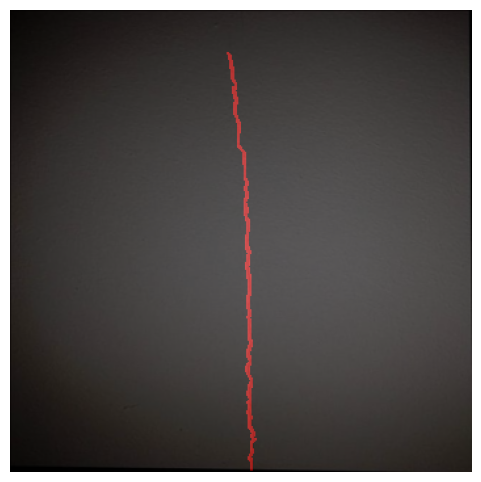

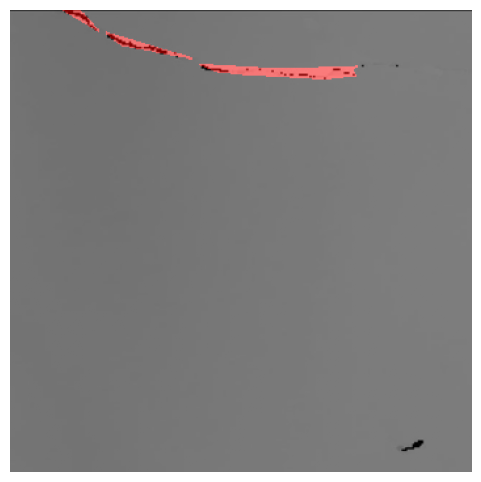

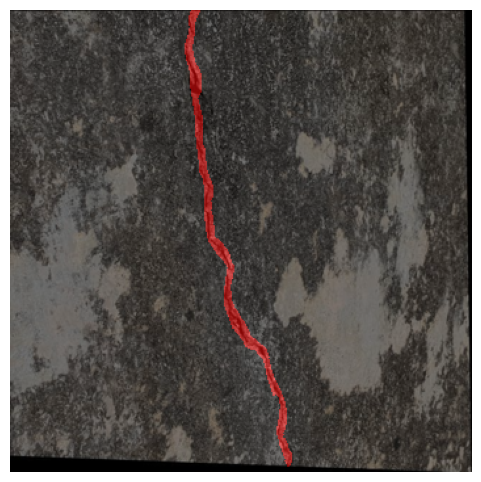

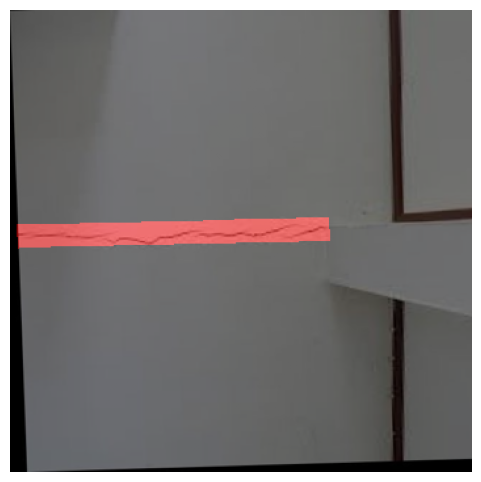

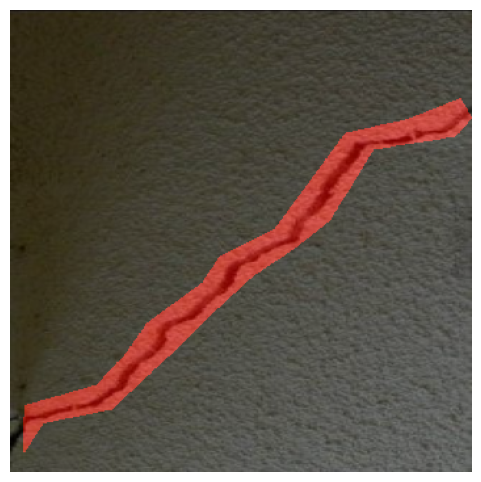

...

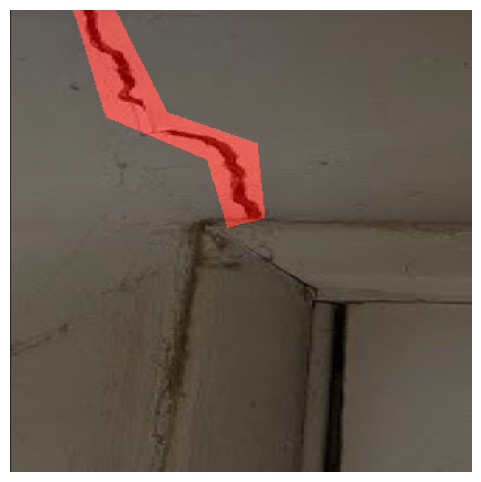

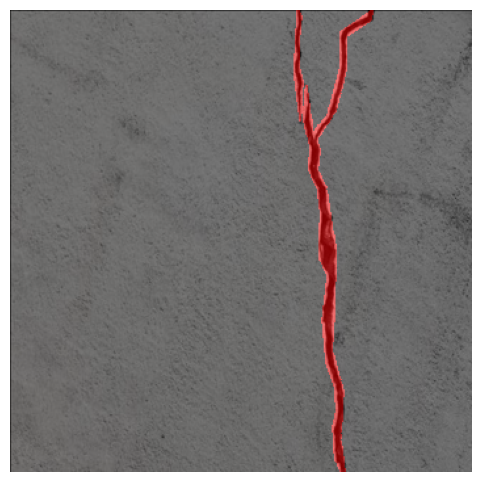

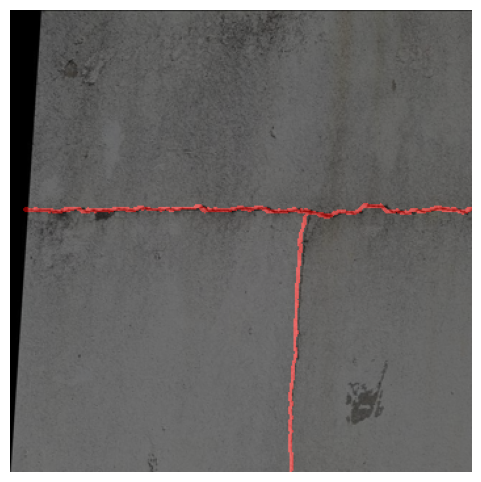

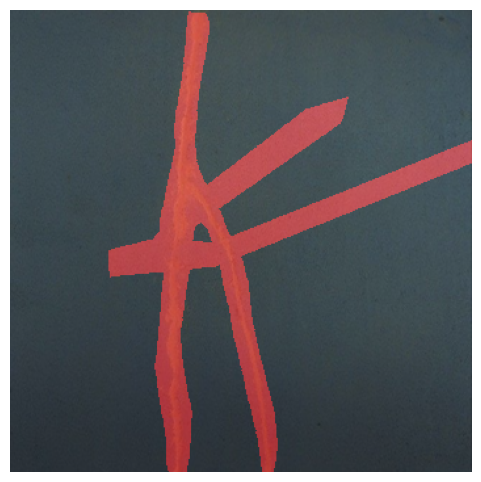

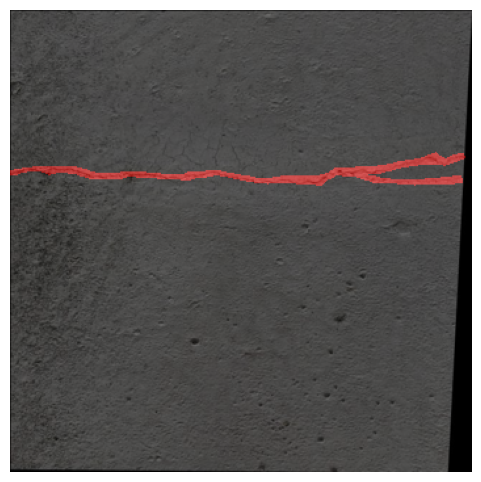

In [ ]:
def show_overlay(image_tensor, mask_tensor, alpha=0.5):
    img = image_tensor.permute(1,2,0).cpu().numpy()
    if mask_tensor.ndim == 3 and mask_tensor.shape[0]==1:
        mask_tensor = mask_tensor.squeeze(0)
    mask_tensor = TF.resize(mask_tensor, img.shape[:2])
    mask = mask_tensor.cpu().numpy()
    mask_color = np.zeros_like(img)
    mask_color[mask>0] = [1,0,0]  # red overlay
    overlay = img * (1-alpha) + mask_color * alpha
    plt.figure(figsize=(6,6))
    plt.imshow(overlay)
    plt.axis('off')
    plt.show()

batch = next(iter(val_loader))
for i in range(len(batch["pixel_values"])):
    show_overlay(batch["pixel_values"][i], batch["labels"][i])
